In [1]:
import pandas as pd
import pathlib
import json
from IPython.display import Image
import PIL.Image
import numpy as np
import sklearn.metrics
from PIL import ImageDraw, ImageFont
import torch
import japanize_matplotlib
import seaborn as sns

In [2]:
RESULT_PATH = '../results/class7_resnet50_batch30_lr1e-05_commit6241653_202112070034'

In [3]:
results = list(pathlib.Path(RESULT_PATH).glob('result_val*'))
last_result = sorted(results)[-1]
params = json.load((pathlib.Path(RESULT_PATH) / 'params.json').open())

In [4]:
params

{'classes': ['北海道旭川市',
  '東京都中央区',
  '東京都千代田区',
  '東京都新宿区',
  '東京都江東区',
  '東京都渋谷区',
  '東京都港区'],
 'batch_size': 30,
 'train_ratio': 0.9,
 'lr': 1e-05,
 'weight_decay': 0,
 'epoch': 200,
 'model': 'resnet50',
 'num_workers': 6,
 'data_sizes': {'train': 26432, 'val': 2937},
 'git_commit_id': '6241653',
 'use_gpu': True}

In [5]:
result_df = pd.read_csv(last_result)

# confusion matrix 

<AxesSubplot:xlabel='正解', ylabel='予測'>

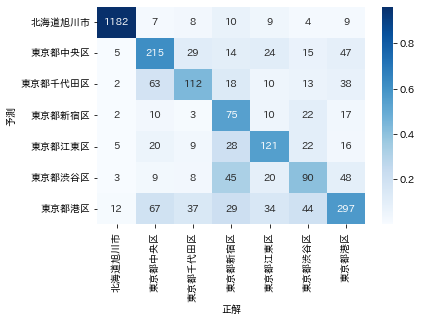

In [6]:
confmat = result_df.assign(
    predict_name=lambda df: df.predict.map(lambda x: params["classes"][x]),
    label_name=lambda df: df.label.map(lambda x: params["classes"][x])
).rename(
    columns={
        "label_name": "正解",
        "predict_name": "予測",
    }
).pivot_table(index="予測", columns="正解", aggfunc=len)["file"]

sns.heatmap(confmat / confmat.sum(axis=1), annot=confmat, fmt="d", cmap="Blues")

# ランダム出力

In [7]:
import numpy as np
def softmax(x):
    """Compute softmax values for each sets of scores in x."""
    e_x = np.exp(x - np.max(x))
    return e_x / e_x.sum(axis=0) # only difference

In [8]:
def imagedraw(
    row, params, target=None, place=True, show_result=True,
    subtitle=None
    ):
    image = PIL.Image.open('../'+row.file)
    draw = ImageDraw.Draw(image)
    font = ImageFont.truetype("ヒラギノ角ゴシック W7.ttc", size=40)
    if show_result:
        text = "予測: " + params["classes"][row.predict]
        draw.text((70, 170), text, font=font, fill=(255, 0, 0))
        text = "正解: " + params["classes"][row.label]
        draw.text((70, 220), text, font=font, fill=(255, 255, 255))
    if target:
        score_columns = [key for key in row.keys() if key.find("score") >= 0]
        score = softmax(row[score_columns].tolist())
        row_scored = {key: value for key, value in zip(score_columns, score)}
        text = f"{target.replace('東京都', '').replace('北海道', '')}スコア: \n{row_scored[f'score[{target}]']: .3f}"
        draw.text((70, 290), text, font=font, fill=(255, 255, 255))
    if place:
        p = pathlib.Path(row.file).parent.stem
        draw.text((20, 20), p, font=font, fill=(0, 0, 255))
    if subtitle:
        draw.text((200, 380), subtitle, font=font, fill=(255, 0, 0))

    return image


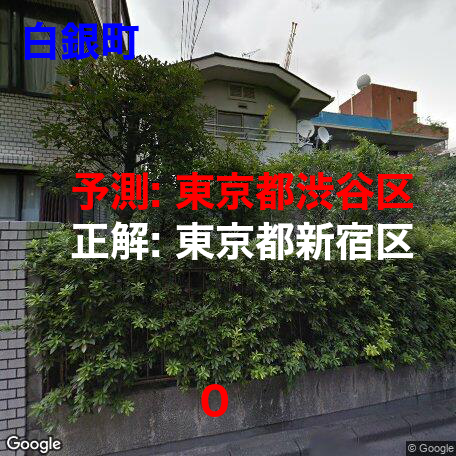

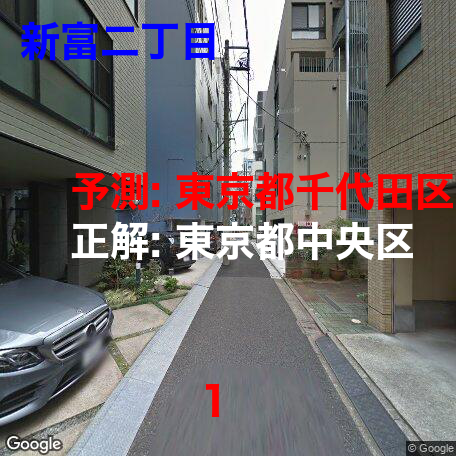

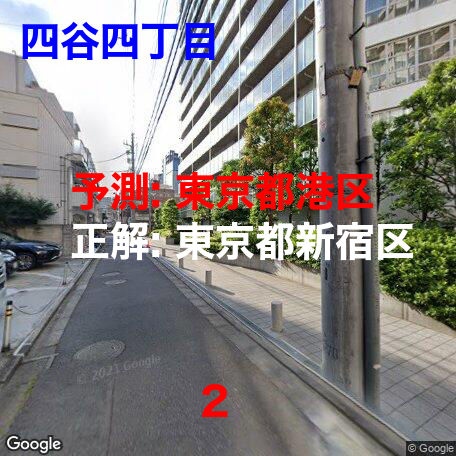

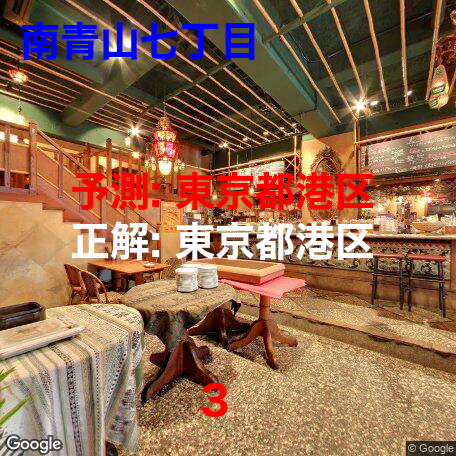

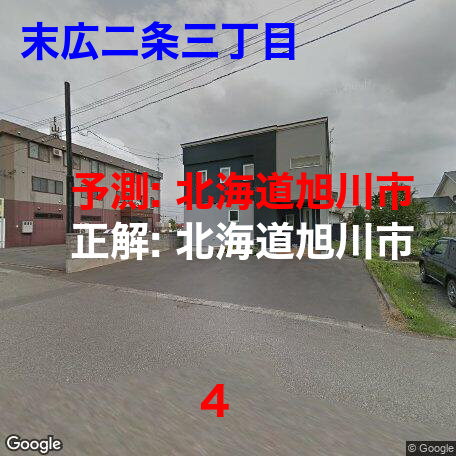

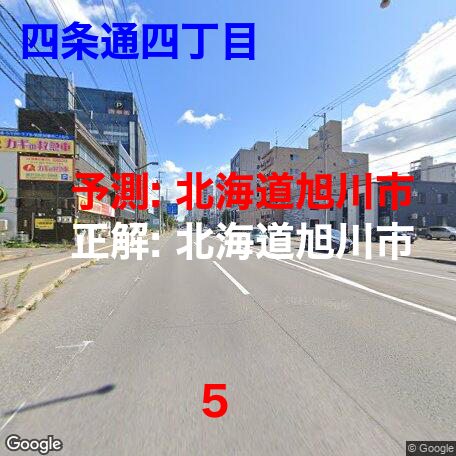

In [9]:
images = []
# for i, row in result_df.query('file.str.contains("港区")').iterrows():
for i, row in result_df.iterrows():
    PIL.Image.open('../'+row.file).save(f"original_{i}.png")
    image = imagedraw(row, params, subtitle=f"{i}")
    display(image)
    image.save(f"{i}.png")
    images.append(image)
    if i == 5:
        break
images[0].save('out.gif', save_all=True, append_images=images[1:], duration=500, loop=0)

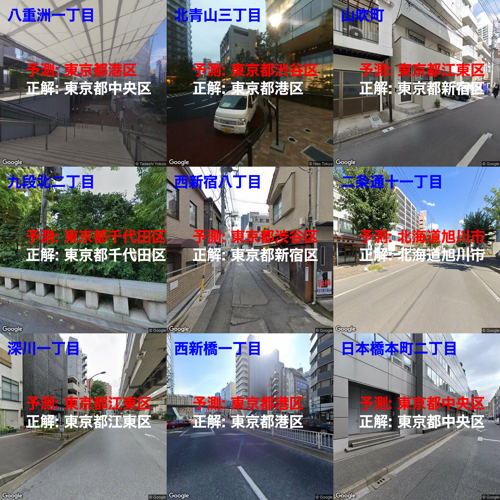

In [10]:
TARGET = np.array([[15, 18, 19], [25, 29, 30], [31, 36, 37]])
sample = imagedraw(result_df.iloc[0], params)
result_img = PIL.Image.new(
    'RGB', 
    (
        sample.width * TARGET.shape[1], 
        sample.height * TARGET.shape[0]))
for i_a, line in enumerate(TARGET):
    for i_b, target_index in enumerate(line):
        r = result_df.iloc[target_index]
        # image = PIL.Image.open('../'+r.file)
        image = imagedraw(r, params)
        # image = imagedraw(r, params, show_result=False, target=class_b)
        # image = imagedraw(r, params, show_result=False)
        result_img.paste(image, (i_b * sample.width, i_a*sample.height))
        # print(class_a, class_b)
display(result_img.resize((500, 500)))


# 最もXXX区らしいYYY

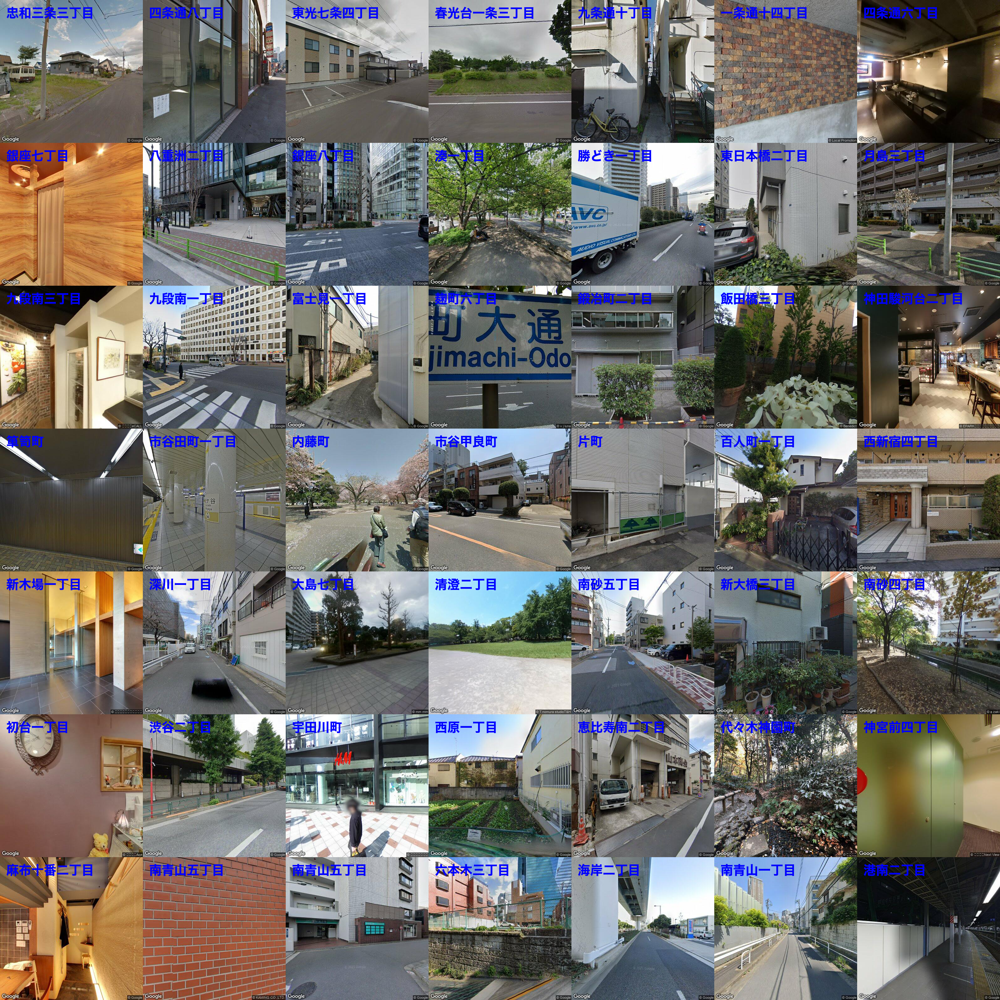

In [11]:
sample = imagedraw(result_df.iloc[0], params)
result_img = PIL.Image.new(
    'RGB', 
    (
        sample.width * len(params["classes"]), 
        sample.height * len(params["classes"])))
for i_a, class_a in enumerate(params["classes"]):
    for i_b, class_b in enumerate(params["classes"]):
        r = result_df.query(f'file.str.contains("{class_a}")').sort_values(f'score[{class_b}]', ascending=False).head(1).iloc[0]
        # image = imagedraw(r, params, target=class_b)
        # image = imagedraw(r, params, show_result=False, target=class_b)
        image = imagedraw(r, params, show_result=False)
        result_img.paste(image, (i_b * sample.width, i_a*sample.height))
        # print(class_a, class_b)
display(result_img.resize((1000, 1000)))


# most 港区

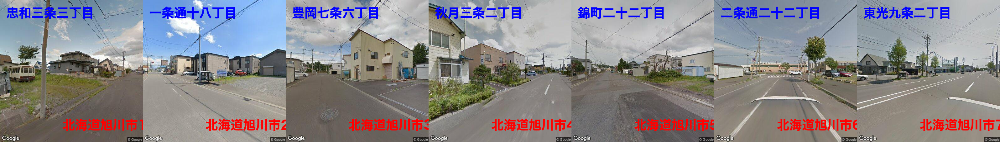

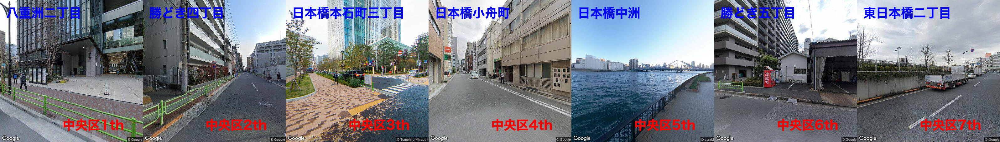

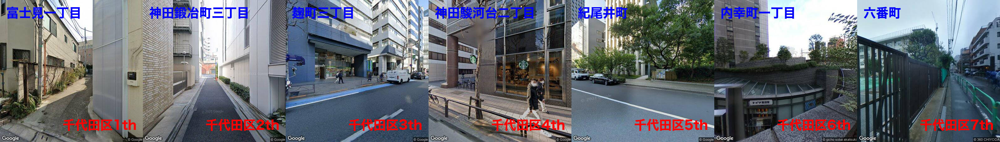

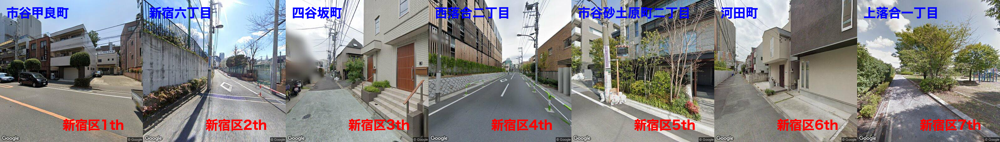

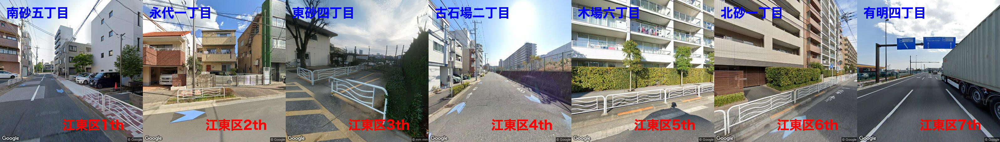

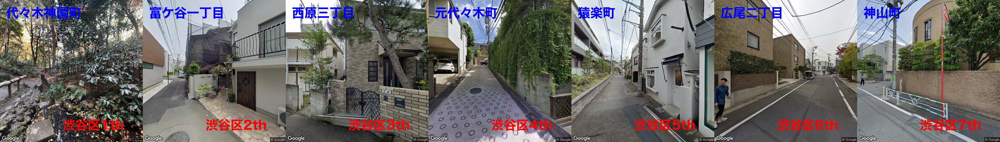

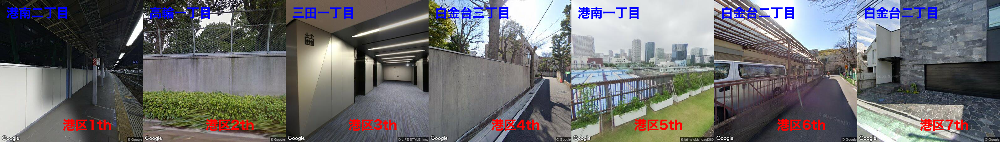

In [12]:
sample = imagedraw(result_df.iloc[0], params)
N = 7
for i_a, class_a in enumerate(params["classes"]):
    soreted_df = result_df.query(f'file.str.contains("{class_a}")').sort_values(f'score[{class_a}]', ascending=False)
    result_img = PIL.Image.new(
        'RGB', 
        (
            sample.width * N, 
            sample.height)
    )
    for i, (i_orig, row) in enumerate(soreted_df.head(N).iterrows()):
        subtitle = class_a.replace('東京都', '')+f'{i+1}th'
        image = imagedraw(row, params, show_result=False, subtitle=subtitle)
        result_img.paste(image, (i * sample.width, 0))
    display(result_img)
    result_img.save(f'{class_a}_top{N}.png')


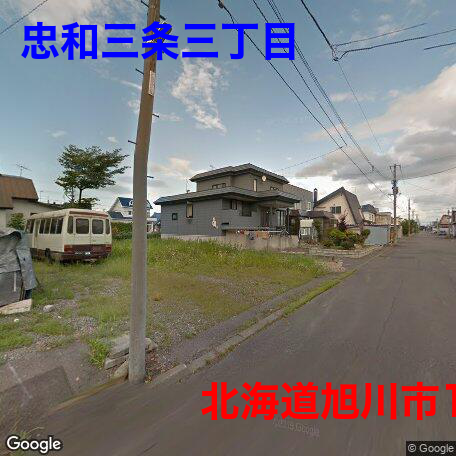

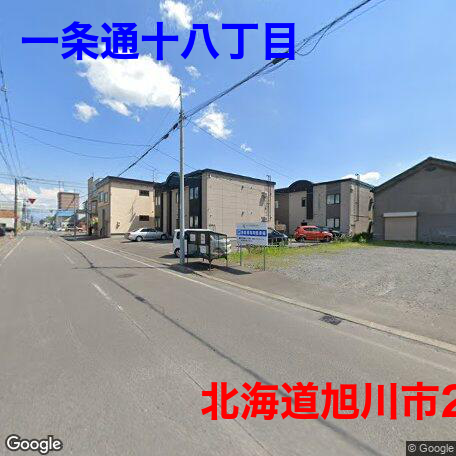

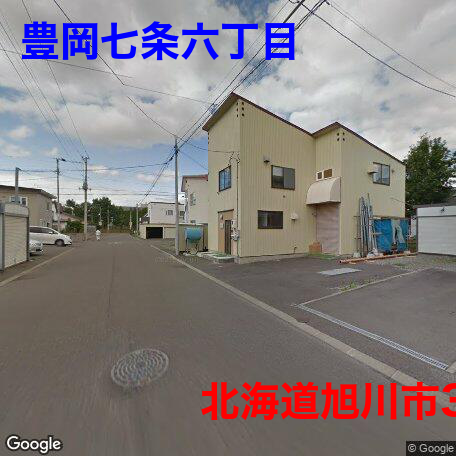

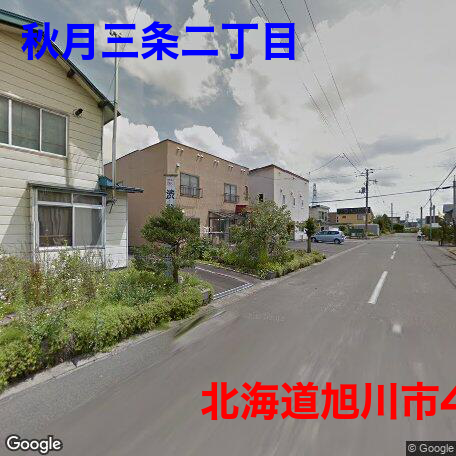

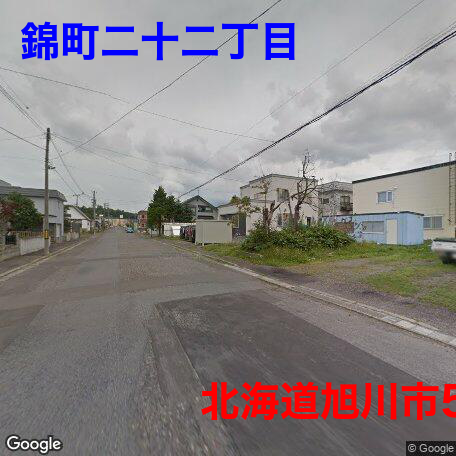

...

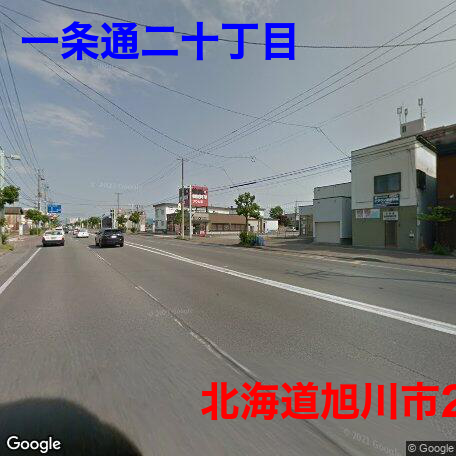

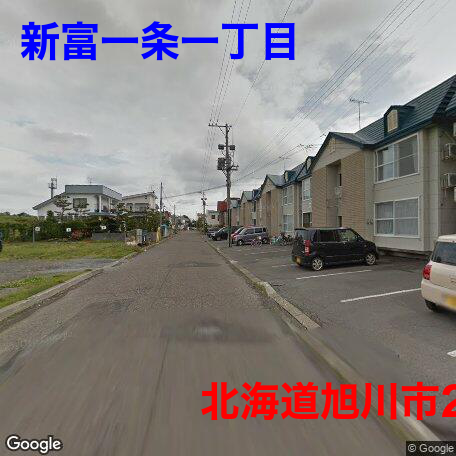

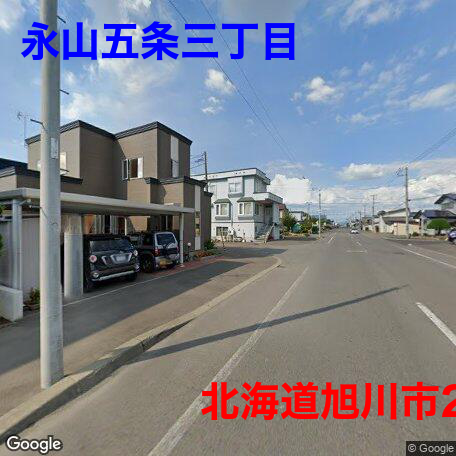

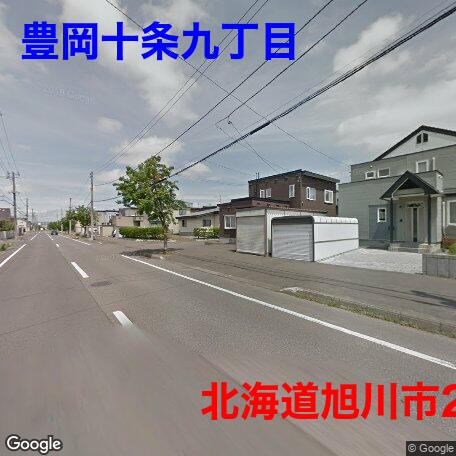

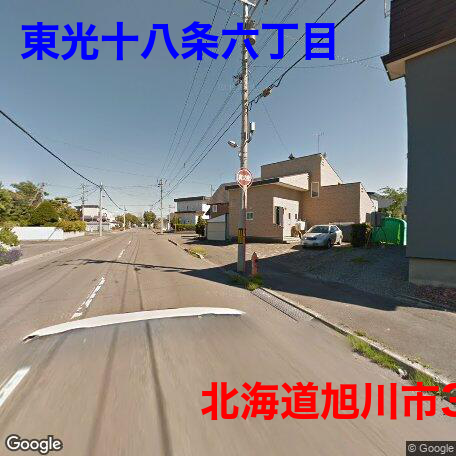

In [13]:
sample = imagedraw(result_df.iloc[0], params)
N = 3
class_a = "北海道旭川市"
soreted_df = result_df.query(f'file.str.contains("{class_a}")').sort_values(f'score[{class_a}]', ascending=False)
for i, (i_orig, row) in enumerate(soreted_df.head(N).iterrows()):
    subtitle = class_a.replace('東京都', '')+f'{i+1}th'
    image = imagedraw(row, params, show_result=False, subtitle=subtitle)
    display(image)
